# enDAQ Custom Analysis

## Introduction

This notebook and accompanying webinar was developed and released by the [enDAQ team](https://endaq.com/). This is the fifth "chapter" of our series on *Python for Mechanical Engineers*:
1. [Get Started with Python](https://colab.research.google.com/drive/1_pcGtgJleapV9tz5WfuRuqfWryjqhPHy#scrollTo=ikUJITDDIp19)
    * Blog: [Get Started with Python: Why and How Mechanical Engineers Should Make the Switch](https://blog.endaq.com/get-started-with-python-why-how-mechanical-engineers-should-make-the-switch)
2. [Introduction to Numpy & Pandas for Data Analysis](https://colab.research.google.com/drive/1O-VwAdRoSlcrineAk0Jkd_fcw7mFGHa4#scrollTo=ce97q1ZcBiwj)
3. [Introduction to Plotly for Plotting Data](https://colab.research.google.com/drive/1pag2pKQQW5amWgRykAH8uMAPqHA2yUfU)
4. [Introduction of the enDAQ Library](https://colab.research.google.com/drive/1WAtQ8JJC_ny0fki7eUABACMA-isZzKB6)
  - There are lots of examples in this!
5. **More Examples! (Today's Webinar)**
  - Frequency Analysis (FFTs and PSDs)
  - Simple Shock Response Spectrums
  - Peak Analysis
  - Preview `endaq.batch`

To sign up for future webinars and watch previous ones, [visit our webinars page](https://endaq.com/pages/shock-vibration-webinars). 

## Installation
[Available on PyPi](https://pypi.org/project/endaq/) via:
> `pip install endaq`

For the most recent features that are still under development, you can also use pip to install endaq directly from GitHub:
> `pip install git+https://github.com/MideTechnology/endaq-python.git@development`

In [ ]:
!pip install -q endaq
!pip install -q kaleido #this is for rendering images with plotly
exit() #needed in Colab because they pre-load some libraries, wouldn't be neccessary if running locally

     |████████████████████████████████| 71 kB 3.0 MB/s 
     |████████████████████████████████| 11.3 MB 13.0 MB/s 
     |████████████████████████████████| 62 kB 749 kB/s 
     |████████████████████████████████| 38.1 MB 1.3 MB/s 
     |████████████████████████████████| 93 kB 1.0 MB/s 
     |████████████████████████████████| 83 kB 1.0 MB/s 
     |████████████████████████████████| 25.3 MB 51.8 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires pandas~=1.1.0; python_version >= "3.0", but you have pandas 1.3.4 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
     |██████████

In [ ]:
import endaq

endaq.plot.utilities.set_theme(theme='endaq')

import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
import numpy as np
import scipy

## PSDs & FFTs

### Simple Sine Wave

In [ ]:
time = np.linspace(0,2,200,endpoint=False)

sine_waves = pd.DataFrame(index=time)
sine_waves['0.8g @ 2 Hz'] = 0.8*np.sin(2*np.pi*2 * time)
sine_waves['1g @ 3 Hz'] = np.sin(2*np.pi*3 * time)
sine_waves['0.6g @ 5 Hz'] = 0.6*np.sin(2*np.pi*5 * time)
sine_waves['0.5g @ 4 & 6 Hz'] = 0.5*np.sin(2*np.pi*4 * time) + 0.5*np.sin(2*np.pi*6 * time)
sine_waves['0.3g @ 7 Hz'] = 0.3*np.sin(2*np.pi*7 * time)

sine_waves

,0.8g @ 2 Hz,1g @ 3 Hz,0.6g @ 5 Hz,0.5g @ 4 & 6 Hz,0.3g @ 7 Hz
0.00,0.000000,0.000000,0.000000,0.000000,0.000000
0.01,0.100267,0.187381,0.185410,0.308407,0.127734
0.02,0.198952,0.368125,0.352671,0.583150,0.231154
0.03,0.294500,0.535827,0.485410,0.794687,0.290575
0.04,0.385403,0.684547,0.570634,0.921177,0.294686
...,...,...,...,...,...
1.95,-0.470228,-0.809017,-0.600000,-0.951057,-0.242705
1.96,-0.385403,-0.684547,-0.570634,-0.921177,-0.294686
1.97,-0.294500,-0.535827,-0.485410,-0.794687,-0.290575
1.98,-0.198952,-0.368125,-0.352671,-0.583150,-0.231154


In [ ]:
fig = px.line(sine_waves)
fig.update_layout(
    title_text='Comparison of Fabricated Sine Waves',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Time (s)',
    legend_title_text=''
)

Now to compute the PSD on this using `endaq.calc.psd.welch()`, [see docs](https://docs.endaq.com/en/latest/endaq/calc.html#endaq.calc.psd.welch)

In [ ]:
psd = endaq.calc.psd.welch(sine_waves, bin_width=0.5)

In [ ]:
fig = px.line(psd)
fig.update_layout(
    title_text='Comparison of the PSD of Two Fabricated Sine Waves',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    legend_title_text=''
)

PSDs are the more appropriate way to analyze vibration data for a number of reasons ([see blog](https://blog.endaq.com/why-the-power-spectral-density-psd-is-the-gold-standard-of-vibration-analysis)) but we typically see people want to see the FFT because it's units are easier to intuitively understand.

In my experience the best way to do this is to compute a PSD using our function with a few modifications:
- Use scaling as `parseval` which means it is `g^2` instead of `g^2/Hz`
- Use a boxcar window so in effect there is no windowing 
- Define a very fine bin width
- Set the overlap between FFTs to 0 (not necessary if the bin width is small enough)
- Scale from g^2 as RMS to g-peak via `**2 * (2**0.5)`

In [ ]:
fft = endaq.calc.psd.welch(
    sine_waves, 
    scaling='parseval',
    window='boxcar',
    noverlap=0,
    bin_width=0.1, 
)
fft = fft**0.5 * (2**0.5) #scale from g^2 as RMS to g-peak

fig = px.line(fft)
fig.update_layout(
    title_text='Comparison of the FFT (from PSD) of Two Fabricated Sine Waves',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    legend_title_text='',
    template='endaq_light'
)

/usr/local/lib/python3.7/dist-packages/scipy/signal/spectral.py:1966: UserWarning:

nperseg = 1000 is greater than input length  = 200, using nperseg = 200



### Real Sine Wave

Let's load a IDE file with `get_doc` [docs](https://docs.endaq.com/en/latest/endaq/ide.html#endaq.ide.get_doc).

In [ ]:
doc = endaq.ide.get_doc('https://info.endaq.com/hubfs/100Hz_shake_cal.ide')
endaq.ide.get_channel_table(doc)

,channel,name,type,units,start,end,duration,samples,rate
0,8.0,X (100g),Acceleration,g,00:00.0218,00:25.0532,00:25.0314,126575,5000.07 Hz
1,8.1,Y (100g),Acceleration,g,00:00.0218,00:25.0532,00:25.0314,126575,5000.07 Hz
2,8.2,Z (100g),Acceleration,g,00:00.0218,00:25.0532,00:25.0314,126575,5000.07 Hz
3,80.0,X (40g),Acceleration,g,00:00.0218,00:25.0547,00:25.0328,100934,3985.00 Hz
4,80.1,Y (40g),Acceleration,g,00:00.0218,00:25.0547,00:25.0328,100934,3985.00 Hz
5,80.2,Z (40g),Acceleration,g,00:00.0218,00:25.0547,00:25.0328,100934,3985.00 Hz
6,36.0,Pressure/Temperature:00,Pressure,Pa,00:00.0217,00:25.0702,00:25.0485,27,1.06 Hz
7,36.1,Pressure/Temperature:01,Temperature,°C,00:00.0217,00:25.0702,00:25.0485,27,1.06 Hz
8,70.0,X,Quaternion,q,00:00.0284,00:24.0682,00:24.0397,2424,99.35 Hz
9,70.1,Y,Quaternion,q,00:00.0284,00:24.0682,00:24.0397,2424,99.35 Hz


Now get the actual data out of one channel with `to_pandas()` [docs](https://docs.endaq.com/en/latest/endaq/ide.html#endaq.ide.to_pandas).

Then generate a plot with `rolling_min_max_envelope()` ([docs](https://docs.endaq.com/en/latest/endaq/plot.html#endaq.plot.rolling_min_max_envelope)) that will instead of plotting all data points make a shaded plot which will look identical to plotting all points but be more responsive and faster (not entirely necessary on this dataset, but becomes so with larger ones).

In [ ]:
accel = endaq.ide.to_pandas(doc.channels[80], time_mode='seconds')
accel = accel-accel.median() #remove DC offset
endaq.plot.rolling_min_max_envelope(
    accel, 
    plot_as_bars=True,
    desired_num_points=1000, 
    opacity=0.7
)

Here we'll plot the raw data around the peak event with `around_peak()` [docs](https://docs.endaq.com/en/latest/endaq/plot.html#endaq.plot.around_peak).

In [ ]:
endaq.plot.around_peak(accel, num=500)

In [ ]:
fft = endaq.calc.psd.welch(
    accel[4.5:9.5], #just do it in time of first dwell
    scaling='parseval',
    window='boxcar',
    noverlap=0,
    bin_width=0.5, 
)
fft = fft**0.5 * (2**0.5) #scale from g^2 as RMS to g-peak

fig = px.line(fft[:500])
fig.update_layout(
    title_text='FFT (from PSD) of Real World 10.3g Sine Wave',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Frequency (Hz)',
    legend_title_text='',
)

### Comparing FFT Options

#### FFT Option Overview
There are a lot of different ways to compute a FFT in Python. I've been using Welch's method so far but I want to compare that to some other more "direct" methods. So let's compare them! First let's conveniently wrap our manipulation of Welch's method PSD into a FFT inside a function.

In [ ]:
def welch_fft(df, bin_width=0.5):
  fft = endaq.calc.psd.welch(df, bin_width=bin_width, scaling='parseval', window='boxcar', noverlap=0)
  return fft**0.5 * (2**0.5) #scale from g^2 as RMS to g-peak  

Now let's wrap something around [Numpy's FFT functions](https://numpy.org/doc/stable/reference/routines.fft.html) for a real discrete Fourier transform.

Notice here we actually have phase information! So we'll return that too.

In [ ]:
def numpy_fft(df):
  """
  Using Numpy's rfft functions compute a discrete Fourier Transform
  """
  freq = np.fft.rfftfreq(len(df), d=endaq.calc.utils.sample_spacing(df))
  df_fft = pd.DataFrame(
    np.fft.rfft(df.to_numpy(), axis=0),
    index=pd.Series(freq, name="frequency (Hz)"),
    columns=df.columns
  )
  
  df_mag = df_fft.apply(np.abs, raw=True) / len(df_fft)
  df_phase = df_fft.apply(np.angle, raw=True)

  return df_mag, df_phase

Now we will use the [FFTW algorithm](http://www.fftw.org/) which is available in the [pyFFTW library](https://hgomersall.github.io/pyFFTW/index.html) under a GPL license (which makes it potentially difficult for us to use because we use the more premissive MIT license).

First let's download it.

In [ ]:
!pip install -q pyfftw

     |████████████████████████████████| 2.6 MB 5.3 MB/s 


Now let's use it in a function which allows for a drop-in replacement to the Numpy code. This algorithm is generally regarded as the fatest for computing discrete Fourier transforms - so we'll put it to the test!

In [ ]:
import pyfftw

def fftw_fft(df):
  """
  Using the FFTW algorithm, compute a discrete Fourier Transform
  """
  freq = pyfftw.interfaces.numpy_fft.rfftfreq(len(df), d=endaq.calc.utils.sample_spacing(df))
  df_fft = pd.DataFrame(
    pyfftw.interfaces.numpy_fft.rfft(df.to_numpy(), axis=0),
    index=pd.Series(freq, name="frequency (Hz)"),
    columns=df.columns
  )
  
  df_mag = df_fft.apply(np.abs, raw=True) / len(df_fft)
  df_phase = df_fft.apply(np.angle, raw=True)

  return df_mag, df_phase  

Now let's see a FFT result with this library. Note though this will be relatively large to plot...

In [ ]:
fft, phase = fftw_fft(accel[4.5:9.5])

fig = px.line(fft[80:120])
fig.update_layout(
    title_text='FFT using FFTW of Real World 10.3g Sine Wave',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Frequency (Hz)',
    legend_title_text='',
)

Remember one of the benefits of the DFT is to get phase. Although not particularly useful for this dataset let's plot it, notice the shift for the Z axis at the drive frequency.

In [ ]:
fig = px.line(phase[80:120])
fig.update_layout(
    title_text='Phase using FFTW of Real World 10.3g Sine Wave',
    yaxis_title_text='Phase Angle (radians)',
    xaxis_title_text='Frequency (Hz)',
    legend_title_text='',
)

#### FFT Option Comparison

Now let's do the fun part to compare the three approaches! First let's make a sine wave with a bit over 1M points.

In [ ]:
time = np.linspace(0,200,2**20,endpoint=False)

sine_waves = pd.DataFrame(index=time)
sine_waves['10g @ 100 Hz'] = 10*np.sin(2*np.pi*100 * time)
sine_waves['8g @ 99 Hz'] = 8*np.sin(2*np.pi*99 * time)
sine_waves['6g @ 100.25 Hz'] = 6*np.sin(2*np.pi*100.25 * time)

In [ ]:
fig = px.line(sine_waves[:0.01])
fig.update_layout(
    title_text='Comparison of Fabricated Sine Waves',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Time (s)',
    legend_title_text=''
)

In [ ]:
from time import process_time
import timeit
pyfftw.forget_wisdom() #FFTW will be faster on subsequent runs

lengths = [2**14, 16411, 2**17, 131101, 2**20, 1000003]

ffts = pd.DataFrame()
times = pd.DataFrame()
def melt_fft(fft,name,L):
  fft =  fft.reset_index().melt(id_vars='frequency (Hz)')
  fft['Algo'] = name
  fft['Length'] = L
  return fft

def time_fft(func):
    return np.array(timeit.repeat(func, number=1, repeat=10)).mean()

def time_pyfftw(x, threads=1):
    pyfftw.forget_wisdom()
    rfft = pyfftw.builders.rfft(x, threads=threads, auto_align_input=True)
    rfft()
    return np.array(timeit.repeat(lambda: rfft(), number=1, repeat=10)).mean()

for L in lengths:
  x = sine_waves.iloc[:L, 0].to_numpy()

  t1 = process_time() 
  wfft_bin = welch_fft(sine_waves.iloc[:L], bin_width=0.5)

  t2 = process_time() 
  wfft = welch_fft(sine_waves.iloc[:L], bin_width=1/(L*endaq.calc.utils.sample_spacing(sine_waves)))

  t3 = process_time() 
  nfft, phase = numpy_fft(sine_waves.iloc[:L])

  t4 = process_time() 
  fftw, phase = fftw_fft(sine_waves.iloc[:L])

  t5 = process_time() 

  times_t = pd.DataFrame(
      {'Welch w/ 0.5 Hz Bin':t2-t1,
       'Welch': t3-t2,
       'Numpy':t4-t3,
       'FFTW':t5-t4,
       'Numpy - No OH': time_fft(lambda: np.fft.rfft(x)),
       'FFTW - No OH': time_pyfftw(x, threads=1)
      },
      index=pd.Series([L],name='Length')
  )
  times = pd.concat([times,times_t.reset_index().melt(id_vars='Length')])

  wfft_bin = melt_fft(wfft_bin.copy(),'Welch w/ 0.5 Hz Bin',L)
  wfft = melt_fft(wfft.copy(),'Welch',L)
  nfft = melt_fft(nfft.copy(),'Numpy',L)
  fftw = melt_fft(fftw.copy(),'FFTW',L)

  ffts = pd.concat([ffts,wfft_bin,wfft,nfft,fftw])  

In [ ]:
times['str_len'] = times['Length'].astype('str')
fig = px.bar(
    times,
    x='str_len',
    y='value',
    color='variable',
    log_y=True,
    barmode='group',
    labels={'value':'Computation Time (s)','str_len':'Array Length','variable':''}
)
fig.show()

In [ ]:
fig = px.scatter(
    times,
    x='str_len',
    y='value',
    color='variable',
    log_y=True,
    log_x=True,
    labels={'value':'Computation Time (s)','str_len':'Array Length','variable':''}
)
fig.show()

So what does this mean!? FFTW is the fastest as expected, but only if we first structure the data in a more efficient way. But typically you will not have the data structured in this "optimal" way for FFTW which means the time it takes to restucture it is real.

Long story short for *this audience*, using Welch's method is fastest!

In [ ]:
fig = px.line(
    ffts[(ffts['frequency (Hz)']>95) & (ffts['frequency (Hz)']<105)],
    x='frequency (Hz)',
    y='value',
    color='Algo',
    facet_col='Length',
    facet_row='variable',
    title='FFTs: Acceleration (g) vs Frequency (Hz)',
    labels={'value':'','frequency (Hz)':''}

)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_layout(width=1200,height=1000)
fig.show()

In [ ]:
fig.write_html('FFT-compare.html',include_plotlyjs='cdn')

When comparing the actual FFT results we notice that Welch's with a fixed frequency bin width gives us identical results regardless of the time duration we use - **and these are the "right" or at least expected result**.

### Random Vibration (NAVMAT PSD)

Let's look at the NAVMAT PSD which is as follows: 
![](https://info.endaq.com/hubfs/navmat-psd.png)


In [ ]:
navmat = pd.read_csv('https://info.endaq.com/hubfs/navmat-p-9492.csv',delimiter='\t',header=None,index_col=0,names=['Random'])
navmat.index.name='Time (s)'

navmat['Add 2g @ 100 Hz'] = navmat.Random + 2*np.sin(2*np.pi*100 * navmat.index)
navmat['Add 2g @ 200 Hz'] = navmat.Random + 2*np.sin(2*np.pi*200 * navmat.index)
navmat['Add 2g @ 400 Hz'] = navmat.Random + 2*np.sin(2*np.pi*400 * navmat.index)
navmat

,Random,Add 2g @ 100 Hz,Add 2g @ 200 Hz,Add 2g @ 400 Hz
Time (s),,,,
0.000000,-8.698490e-07,-8.698490e-07,-8.698490e-07,-8.698490e-07
0.000038,8.459350e-07,4.793334e-02,9.583830e-02,1.914556e-01
0.000076,1.871620e-06,9.583932e-02,1.914566e-01,3.811528e-01
0.000114,3.444110e-06,1.436908e-01,2.866355e-01,5.673498e-01
0.000153,6.051080e-06,1.914608e-01,3.811570e-01,7.483369e-01
...,...,...,...,...
9.999847,3.435810e-02,-1.571110e-01,-3.468213e-01,-7.140265e-01
9.999886,3.562460e-02,-1.080109e-01,-2.509046e-01,-5.315224e-01
9.999924,1.458970e-02,-8.125498e-02,-1.768794e-01,-3.665897e-01


In [ ]:
endaq.plot.rolling_min_max_envelope(navmat, plot_as_bars=True, desired_num_points=500, opacity=0.8)

In [ ]:
endaq.plot.around_peak(navmat, num=1000)

#### FFTs

In [ ]:
fft = welch_fft(navmat, bin_width=1)

fig = px.line(fft[20:2000])
fig.update_layout(
    title_text='NAVMAT P-9492 FFT (1 Hz Bin Width)',
    yaxis_title_text='Acceleration (g)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text=''
)

Now let's demonstrate the trouble with FFTs by varying the length of time we'll use and the bin width/resolution in the FFT.

In [ ]:
bins = ['1/T', 1, 10]
times = [1.0, 10]

ffts = pd.DataFrame()
for bin in bins:
  for time in times:
    bin_t = bin
    if bin=='1/T':
      bin_t = 1/time
    fft = welch_fft(navmat[:time], bin_width=bin_t)
    fft = fft[20:2000].reset_index().melt(id_vars='frequency (Hz)')
    fft['Time'] = time
    fft['Bin Width'] = bin

    ffts = pd.concat([ffts,fft])

ffts     

,frequency (Hz),variable,value,Time,Bin Width
0,20.000229,Random,0.288549,1.0,1/T
1,21.000240,Random,0.169284,1.0,1/T
2,22.000252,Random,0.099324,1.0,1/T
3,23.000263,Random,0.101153,1.0,1/T
4,24.000275,Random,0.100844,1.0,1/T
...,...,...,...,...,...
787,1950.319916,Add 2g @ 400 Hz,0.388329,10.0,10
788,1960.321557,Add 2g @ 400 Hz,0.369708,10.0,10
789,1970.323197,Add 2g @ 400 Hz,0.335365,10.0,10
790,1980.324838,Add 2g @ 400 Hz,0.378497,10.0,10


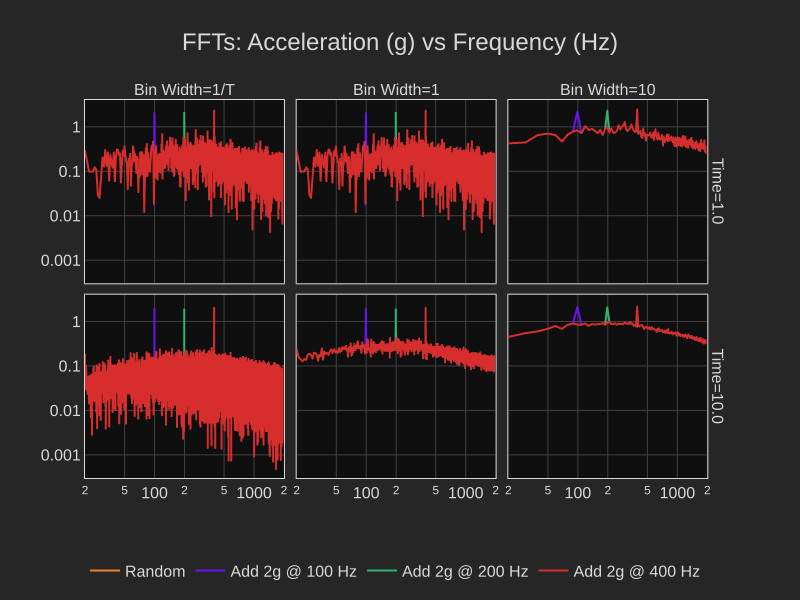

In [ ]:
fig = px.line(
    ffts,
    x='frequency (Hz)',
    y='value',
    color='variable',
    log_y=True,
    log_x=True,
    facet_row='Time',
    facet_col='Bin Width',
    title='FFTs: Acceleration (g) vs Frequency (Hz)',
    labels={'value':'',
            'frequency (Hz)':'',
            'variable':''}

)
fig.update_layout(width=800,height=600)
fig.show(renderer='svg')

Our peaks stay consistent around the 2g we'd expect... but what is happening with the other frequency content!?

#### PSDs

In [ ]:
psd = endaq.calc.psd.welch(navmat,bin_width=1)

fig = px.line(psd[20:2000])
fig.update_layout(
    title_text='NAVMAT P-9492 PSD (1 Hz Bin Width)',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text=''
)

Now let's do the same comparison of PSDs

In [ ]:
psds = pd.DataFrame()
for bin in bins:
  for time in times:
    bin_t = bin
    if bin=='1/T':
      bin_t = 1/time
    psd = endaq.calc.psd.welch(
        navmat[:time], bin_width=bin_t)
    psd = psd[20:2000].reset_index().melt(id_vars='frequency (Hz)')
    psd['Time'] = time
    psd['Bin Width'] = bin

    psds = pd.concat([psds,psd])
  

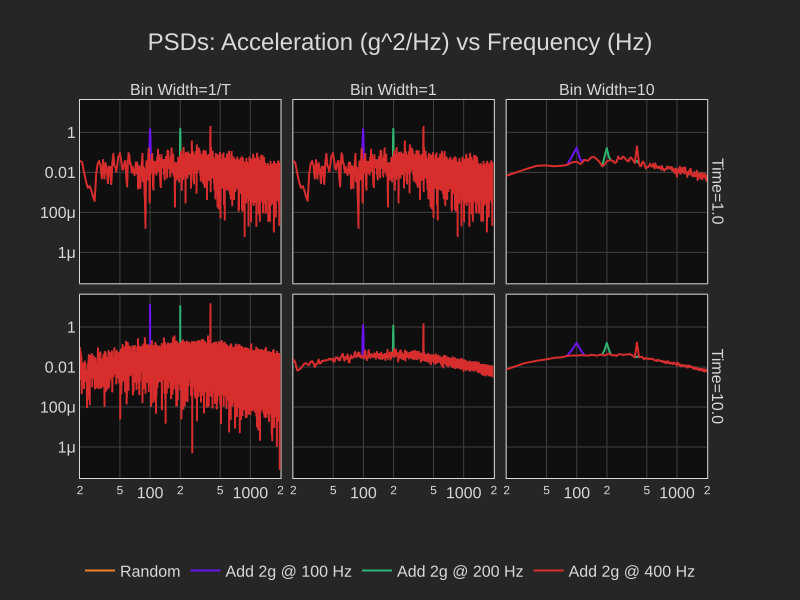

In [ ]:
fig = px.line(
    psds,
    x='frequency (Hz)',
    y='value',
    color='variable',
    log_y=True,
    log_x=True,
    facet_row='Time',
    facet_col='Bin Width',
    title='PSDs: Acceleration (g^2/Hz) vs Frequency (Hz)',
    labels={'value':'',
            'frequency (Hz)':'',
            'variable':''}

)
fig.update_layout(width=800,height=600)
fig.show(renderer='svg')

The peak at those sine tones decrease **yet** the bin width was wider and that sine tone was at one single frequency... so it is less dense. But then the other random/broadband levels are consistent regardless of our length of time or frequency resolution.

#### PSD Frequency Resolution and Octave Spacing

In [ ]:
psd_coarse = endaq.calc.psd.welch(navmat,bin_width=10)

fig = px.line(psd_coarse[20:2000])
fig.update_layout(
    title_text='NAVMAT P-9492 PSD (10 Hz Bin Width)',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text=''
)

Convert to an octave spaced PSD with `to_octave()` [docs](https://docs.endaq.com/en/latest/endaq/calc.html#endaq.calc.psd.to_octave).

In [ ]:
psd = endaq.calc.psd.welch(navmat,bin_width=1)
oct_psd = endaq.calc.psd.to_octave(psd,fstart=20,octave_bins=3)

fig = px.line(oct_psd[:2000])
fig.update_layout(
    title_text='NAVMAT P-9492 PSD 1/3 Octave',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text='',
    template='endaq_light'
)

/usr/local/lib/python3.7/dist-packages/endaq/calc/psd.py:161: RuntimeWarning:

empty frequency bins in re-binned PSD; original PSD's frequency spacing is too coarse



#### Cumulative Sum from PSD

In [ ]:
cum_rms = endaq.calc.psd.welch(navmat,bin_width=1, scaling='parseval').cumsum()**0.5

fig = px.line(cum_rms[10:2000])
fig.update_layout(
    title_text='NAVMAT P-9492 PSD with Added Sine Tone',
    yaxis_title_text='Cumulative Acceleration RMS (g)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    legend_title_text=''
)

### Random Vibration Examples

#### Bearing
The first example was the topic of our blog on [top 12 vibration metrics](https://blog.endaq.com/top-vibration-metrics-to-monitor-how-to-calculate-them).

In [ ]:
bearing = pd.read_csv('https://info.endaq.com/hubfs/Plots/bearing_data.csv', index_col=0)

In [ ]:
endaq.plot.rolling_min_max_envelope(bearing, plot_as_bars=True, desired_num_points=500, opacity=0.8)

In [ ]:
psd = endaq.calc.psd.welch(bearing,bin_width=10)

fig = px.line(psd)
fig.update_layout(
    title_text='Bearing Vibration',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text='',
    template='endaq_light'
)

#### Car Engine
During a morning commute (many years ago) I mounted an enDAQ sensor to the car's engine.

In [ ]:
engine = endaq.ide.to_pandas(endaq.ide.get_doc('https://info.endaq.com/hubfs/data/Commute.ide').channels[8])
engine = endaq.calc.filters.butterworth(engine,low_cutoff=1)

In [ ]:
endaq.plot.rolling_min_max_envelope(engine, plot_as_bars=True, desired_num_points=500, opacity=0.8)

In [ ]:
psd = endaq.calc.psd.welch(engine,bin_width=1)

fig = px.line(psd)
fig.update_layout(
    title_text='VIbration of an Engine',
    yaxis_title_text='Acceleration (g^2/Hz)',
    xaxis_title_text='Frequency (Hz)',
    xaxis_type='log',
    yaxis_type='log',
    legend_title_text='',
    template='endaq_light'
)

Here we'll use the `octave_spectrogram()` ([see docs](https://docs.endaq.com/en/latest/endaq/plot.html#endaq.plot.octave_spectrogram)) to generate a spectrogram with log spaced frequency bins.

In [ ]:
data, fig = endaq.plot.octave_spectrogram(engine[['Z']], window=2, bins_per_octave=24, freq_start= 20, max_freq=100)
fig.show()

/usr/local/lib/python3.7/dist-packages/endaq/calc/psd.py:161: RuntimeWarning:

empty frequency bins in re-binned PSD; original PSD's frequency spacing is too coarse



In [ ]:
data = 10 ** (data/10)

fig = px.line(data[data.index<500].idxmax())
fig.update_layout(
    title_text="Moving Peak Frequency",
    xaxis_title_text="",
    yaxis_title_text="Peak Frequency (Hz)",
    showlegend=False
)
fig.show()

## Quick Poll - What FFT Support Should We Add?

Remember this is an open source library you can view, comment and "react" to feature requests and bug reports. [Here is an "issue" created to document this need to add some FFT support](https://github.com/MideTechnology/endaq-python/issues/77).

## Simple Shock Response Spectrums
We'll look at two datasets in our [blog on pseudo velocity](https://blog.endaq.com/shock-analysis-response-spectrum-srs-pseudo-velocity-severity).

### Punching Bag

In [ ]:
punch = endaq.ide.to_pandas(endaq.ide.get_doc('https://info.endaq.com/hubfs/data/Punching-Bag.ide').channels[8], time_mode='seconds')
punch = punch - punch.median()

In [ ]:
endaq.plot.rolling_min_max_envelope(punch, plot_as_bars=True, desired_num_points=500, opacity=0.8)

In [ ]:
fig = endaq.plot.around_peak(punch, num=1000, leading_ratio=0.2)
fig.update_layout(
    xaxis_title_text='',
    yaxis_title_text='Acceleration (g)',
    legend_title_text=''
)

First determine the frequency bins to calculate it at.

In [ ]:
freqs = endaq.calc.utils.logfreqs(punch[29:30], bins_per_octave=12)

Now perform the shock response spectrum calculation for those frequencies.

In [ ]:
srs_punch = endaq.calc.shock.shock_spectrum(punch[29:30], freqs=freqs, damp=0.05, mode='srs')

Now plot!

In [ ]:
fig = px.line(srs_punch)
fig.update_layout(
    title_text='Shock Response Spectrum (SRS) of Punching Bag',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Peak Acceleration (g)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

Repeat for the PVSS.

In [ ]:
pvss_punch = endaq.calc.shock.shock_spectrum(punch[29:30], freqs=freqs, damp=0.05, mode='pvss')
pvss_punch = pvss_punch*9.81*39.37 #convert to in/s

In [ ]:
fig = px.line(pvss_punch)
fig.update_layout(
    title_text='Psuedo Velocity Shock Spectrum (PVSS) of Punching Bag',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Psuedo Velocity (in/s)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

### MIL-S-901D Barge Shock

In [ ]:
barge = pd.read_csv('https://info.endaq.com/hubfs/data/mil-s-901d-barge.csv', names=['Time (s)','Accel (g)']).set_index('Time (s)')
barge = barge - barge.median()

In [ ]:
endaq.plot.rolling_min_max_envelope(barge, plot_as_bars=True, desired_num_points=500, opacity=0.8)

In [ ]:
fig = endaq.plot.around_peak(barge, num=1000, leading_ratio=0.2)
fig.update_layout(
    xaxis_title_text='',
    yaxis_title_text='Acceleration (g)',
    showlegend=False
)

First determine the frequency bins to calculate it at. Here though we will specify an initial frequency of one lower than the duration.

In [ ]:
freqs = endaq.calc.utils.logfreqs(barge, init_freq=1, bins_per_octave=12)

/usr/local/lib/python3.7/dist-packages/endaq/calc/utils.py:54: RuntimeWarning:

the data's duration is too short to accurately represent an initial frequency of 1.000 Hz



Now perform the shock response spectrum calculation for those frequencies.

In [ ]:
srs_barge = endaq.calc.shock.shock_spectrum(barge, freqs=freqs, damp=0.05, mode='srs')

Now plot!

In [ ]:
fig = px.line(srs_barge)
fig.update_layout(
    title_text='Shock Response Spectrum (SRS) of MIL-S-901 Barge',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Peak Acceleration (g)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

Repeat for the PVSS.

In [ ]:
pvss_barge = endaq.calc.shock.shock_spectrum(barge, freqs=freqs, damp=0.05, mode='pvss')
pvss_barge = pvss_barge*9.81*39.37 #convert to in/s

In [ ]:
fig = px.line(pvss_barge)
fig.update_layout(
    title_text='Psuedo Velocity Shock Spectrum (PVSS) of MIL-S-901 Barge',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Psuedo Velocity (in/s)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

### Compare

In [ ]:
srs_punch = srs_punch[['Z (100g)']].reset_index().melt(id_vars='frequency (Hz)')
srs_punch['variable'] = 'Punching Bag (80g Peak)'

srs_barge = srs_barge.reset_index().melt(id_vars='frequency (Hz)')
srs_barge['variable'] = 'MIL-S-901 (600g Peak)'

srs_combined = pd.concat([srs_punch, srs_barge])

In [ ]:
fig = px.line(
    srs_combined,
    x='frequency (Hz)',
    y='value',
    color='variable'
)
fig.update_layout(
    title_text='Shock Response Spectrum (SRS) Comparison',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Peak Acceleration (g)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

In [ ]:
pvss_punch = pvss_punch[['Z (100g)']].reset_index().melt(id_vars='frequency (Hz)')
pvss_punch['variable'] = 'Punching Bag (80g Peak)'

pvss_barge = pvss_barge.reset_index().melt(id_vars='frequency (Hz)')
pvss_barge['variable'] = 'MIL-S-901 (600g Peak)'

pvss_combined = pd.concat([pvss_punch, pvss_barge])

In [ ]:
fig = px.line(
    pvss_combined,
    x='frequency (Hz)',
    y='value',
    color='variable'
)
fig.update_layout(
    title_text='Psuedo Velocity Shock Spectrum (PVSS) Comparison',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Psuedo Velocity (in/s)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

## Peak Finding

In [ ]:
bumps = endaq.ide.to_pandas(endaq.ide.get_doc('https://info.endaq.com/hubfs/data/Robotic-Bumps.ide').channels[80], time_mode='seconds')
bumps = bumps - bumps.median()

In [ ]:
fig = endaq.plot.rolling_min_max_envelope(bumps, plot_as_bars=True, desired_num_points=500, opacity=0.8)
fig.show()

Now we'll use [SciPy's find_peaks](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.find_peaks.html) function to isolate the major events.

In [ ]:
peak_times, _ = scipy.signal.find_peaks(
    x = bumps['Y (40g)'].abs(),
    distance = 5 / endaq.calc.utils.sample_spacing(bumps), #spaced 5 seconds apart
    height = 8
)

Let's add them to the previous plot!

In [ ]:
fig.add_trace(go.Scatter(
    x=bumps.iloc[peak_times].index,
    y=bumps.iloc[peak_times]['Y (40g)'],
    name='Peaks',
    mode='markers',
    marker_size=10,
    marker_color='#D72D2D'
))
fig.show()

Now let's plot the peak event with the identified peak.

In [ ]:
fig = endaq.plot.around_peak(bumps, num=1000, leading_ratio=0.2)
fig.update_layout(
    xaxis_title_text='',
    yaxis_title_text='Acceleration (g)',
    legend_title_text=''
)
fig.add_trace(go.Scatter(
    x=[bumps.iloc[peak_times[2]].name],
    y=[bumps.iloc[peak_times[2]]['Y (40g)']],
    name='Peak',
    mode='markers',
    marker_size=10,
    marker_color='#D72D2D'
))
fig.show()

### PVSS of Full Time History

In [ ]:
freqs = endaq.calc.utils.logfreqs(bumps, init_freq=1, bins_per_octave=12)
pvss_bumps = endaq.calc.shock.shock_spectrum(bumps, freqs=freqs, damp=0.05, mode='pvss')
pvss_bumps = pvss_bumps*9.81*39.37 #convert to in/s

In [ ]:
fig = px.line(pvss_bumps)
fig.update_layout(
    title_text='Psuedo Velocity Shock Spectrum (PVSS) of Robotic "Bumps"',
    xaxis_title_text="Natural Frequency (Hz)",
    yaxis_title_text="Psuedo Velocity (in/s)",
    legend_title_text='',
    xaxis_type="log",
    yaxis_type="log",
  )

You may be surprised to see the X axis actually had higher peak velocities than the Y axis because of where the frequency content lies!

### Loop Through All Peaks

In [ ]:
pvss_all = pd.DataFrame()

for peak in peak_times:
  freqs = endaq.calc.utils.logfreqs(bumps.iloc[peak-1000:peak+4000], init_freq=1, bins_per_octave=12)
  pvss = endaq.calc.shock.shock_spectrum(bumps.iloc[peak-1000:peak+4000], freqs=freqs, damp=0.05, mode='pvss')*9.81*39.37 #convert to in/s
  pvss = pvss.reset_index().melt(id_vars='frequency (Hz)')
  pvss['Peak'] = np.abs(bumps.iloc[peak]['Y (40g)'])
  pvss['Time'] = bumps.index[peak]

  pvss_all = pd.concat([pvss_all,pvss])

In [ ]:
pvss_all['Peak'] = np.round(pvss_all['Peak'],1)
fig = px.line(
    pvss_all,
    x='frequency (Hz)',
    y='value',
    facet_col='variable',
    color='Peak',
    hover_data=['value','Time'],
    log_x=True,
    log_y=True,
    title='Comparison of PVSS for Each Event',
    labels={'value':'Peak Pseudo Velocity (in/s)','frequency (Hz)':''}
)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.show()

Notice how the peak at 23.5g has a pseudo velocity about 1/2 that compared to the peak at virtually all the other events, including the one at 12.8g.

## Preview of Batch

This is currently available, [see docs](https://docs.endaq.com/en/latest/endaq/batch.html), but we are working on a few bug fixes and improved functionality. This module allows you to batch process many *IDE* (only works for our sensors for now).

In a seperate document I first executed the following code to gather all the .IDE files I wanted to analyze (I hide the actual folder name).
~~~python
import glob
directory = r"C:\Users\shanly\enDAQ-Notebooks\..."+"\\"

files = glob.glob(directory+"*.ide*") #get all the files in that directory with a .ide extension
~~~

Then with this list of files, I performed the batch operation with the following.
~~~python
calc_output = (
    endaq.batch.GetDataBuilder(accel_highpass_cutoff=1)
    .add_psd(freq_bin_width=1)
    .add_metrics()
    .aggregate_data(files)
)
file_data = calc_output.dataframes
~~~

Then I saved the output dataframes of interest to pickles that I will load next!
~~~python
file_data['psd'].to_pickle('batch_psd.pkl', protocol=4)
file_data['metrics'].to_pickle('batch_metrics.pkl', protocol=4)
~~~

Note that I obscured the actual filenames (that would have contained the path) with these lines prior to saving.
~~~python
file_data['metrics'].filename = file_data['metrics'].filename.str.split('\\').str[-1].str.split('.IDE').str[0]
file_data['psd'].filename = file_data['psd'].filename.str.split('\\').str[-1].str.split('.IDE').str[0]
~~~

### Metrics

In [ ]:
metrics = pd.read_pickle('https://info.endaq.com/hubfs/data/batch_metrics.pkl')
metrics

,filename,calculation,axis,value,serial number,start time
0,DAQ11409_000061,RMS Acceleration,X (40g),0.050146,11409,2021-10-27 17:33:19.722259
1,DAQ11409_000061,RMS Velocity,X (40g),44.938216,11409,2021-10-27 17:33:19.722259
2,DAQ11409_000061,RMS Displacement,X (40g),5.836992,11409,2021-10-27 17:33:19.722259
3,DAQ11409_000061,Peak Absolute Acceleration,X (40g),0.906830,11409,2021-10-27 17:33:19.722259
4,DAQ11409_000061,Peak Pseudo Velocity Shock Spectrum,X (40g),0.002361,11409,2021-10-27 17:33:19.722259
...,...,...,...,...,...,...
148258,DAQ11409_005795,RMS Angular Velocity,X,1.541428,11409,2021-11-16 19:52:53.617858
148259,DAQ11409_005795,RMS Angular Velocity,Y,0.344340,11409,2021-11-16 19:52:53.617858
148260,DAQ11409_005795,RMS Angular Velocity,Z,0.057123,11409,2021-11-16 19:52:53.617858
148261,DAQ11409_005795,Average Temperature,Pressure/Temperature:00,15.580078,11409,2021-11-16 19:52:53.617858


In [ ]:
metrics.calculation.unique()

array(['RMS Acceleration', 'RMS Velocity', 'RMS Displacement',
       'Peak Absolute Acceleration',
       'Peak Pseudo Velocity Shock Spectrum', 'RMS Angular Velocity',
       'Average Temperature'], dtype=object)

In [ ]:
fig = px.scatter(
    metrics[metrics.calculation.isin(['RMS Acceleration', 
                                      'RMS Displacement',
                                      'Peak Absolute Acceleration'])],
    x='start time',
    y='value',
    facet_col='calculation',
    facet_col_wrap=1,
    color='axis',
    labels={'value':'',
            'start time':'',
            'axis':''
           },
    hover_data=['filename']
)
fig.update_layout(height=600)
fig.for_each_annotation(lambda a: a.update(text=a.text.split("=")[-1]))
fig.update_yaxes(matches=None)
fig.show()

### PSDs

In [ ]:
psd = pd.read_pickle('https://info.endaq.com/hubfs/data/batch_psd.pkl')
psd

,filename,axis,frequency (Hz),value,serial number,start time
0,DAQ11409_000061,X (40g),0.000000,7.402487e-10,11409,2021-10-27 17:33:19.722259
1,DAQ11409_000061,Y (40g),0.000000,2.419061e-08,11409,2021-10-27 17:33:19.722259
2,DAQ11409_000061,Z (40g),0.000000,4.245836e-09,11409,2021-10-27 17:33:19.722259
3,DAQ11409_000061,Resultant,0.000000,2.917670e-08,11409,2021-10-27 17:33:19.722259
4,DAQ11409_000061,X (40g),1.003505,4.808626e-09,11409,2021-10-27 17:33:19.722259
...,...,...,...,...,...,...
2876195,DAQ11409_005795,Resultant,124.448957,7.143454e-08,11409,2021-11-16 19:52:53.617858
2876196,DAQ11409_005795,X (40g),125.452578,1.768300e-08,11409,2021-11-16 19:52:53.617858
2876197,DAQ11409_005795,Y (40g),125.452578,3.348997e-09,11409,2021-11-16 19:52:53.617858
2876198,DAQ11409_005795,Z (40g),125.452578,5.949278e-08,11409,2021-11-16 19:52:53.617858


Now we want to aggregate this see how things changed over time. So we'll round the frequency values and focus on one axis. For readability we'll also make a new column that will display time into the test in days.

In [ ]:
psd['frequency (Hz)'] = np.round(psd['frequency (Hz)'] ,0) 
psd['start time'] = pd.to_datetime(psd['start time'])
psd['Test Day'] = psd['start time']-psd['start time'].iloc[0]
psd['Test Day'] = np.round(psd['Test Day'].dt.total_seconds()/60/60/24,3)

psd_y = psd[psd.axis=='Y (40g)'].copy()
psd_y

,filename,axis,frequency (Hz),value,serial number,start time,Test Day
1,DAQ11409_000061,Y (40g),0.0,2.419061e-08,11409,2021-10-27 17:33:19.722259,0.000
5,DAQ11409_000061,Y (40g),1.0,2.557175e-07,11409,2021-10-27 17:33:19.722259,0.000
9,DAQ11409_000061,Y (40g),2.0,2.522567e-06,11409,2021-10-27 17:33:19.722259,0.000
13,DAQ11409_000061,Y (40g),3.0,1.247001e-06,11409,2021-10-27 17:33:19.722259,0.000
17,DAQ11409_000061,Y (40g),4.0,7.596711e-08,11409,2021-10-27 17:33:19.722259,0.000
...,...,...,...,...,...,...,...
2876181,DAQ11409_005795,Y (40g),121.0,1.037411e-08,11409,2021-11-16 19:52:53.617858,20.097
2876185,DAQ11409_005795,Y (40g),122.0,6.082880e-09,11409,2021-11-16 19:52:53.617858,20.097
2876189,DAQ11409_005795,Y (40g),123.0,5.461760e-09,11409,2021-11-16 19:52:53.617858,20.097
2876193,DAQ11409_005795,Y (40g),124.0,4.885745e-09,11409,2021-11-16 19:52:53.617858,20.097


#### 2D Waterfall
Let's see how the PSD changes over time in a 2D plot with a bunch of lines (one per time). To help with the visualization we first need to get a bunch of colors to map to.

In [ ]:
from plotly import colors
num_colors = len(psd_y[psd_y['Test Day']<1]['Test Day'].unique())
color_steps = colors.sample_colorscale(px.colors.sequential.Turbo, num_colors)

Now we can make the plot!

In [ ]:
fig = px.line(
    psd_y[psd_y['Test Day']<1],
    x='frequency (Hz)',
    y='value',
    color='Test Day',
    hover_data=['filename','start time'],
    color_discrete_sequence = color_steps
)
fig.update_layout(
    xaxis_title_text='Frequency (Hz)',
    yaxis_title_text='Acceleration (g^2/Hz)',
    legend_title_text='',
    legend_y=-0.7,
    height=800,
    xaxis_type='log',
    yaxis_type='log',
    template='endaq_light'
)

#### 3D Waterfall
I know everyone wants to see the 3D view...

In [ ]:
fig = px.line_3d(
    psd_y[psd_y['Test Day']<1],
    x='frequency (Hz)',
    z='value',
    y='Test Day',
    color='Test Day',
    hover_data=['filename','start time'],
    color_discrete_sequence = color_steps,
    log_x=True,
    log_z=True,
    labels={'value':'Acceleration (g^2/Hz)','frequency (Hz)':'Frequency (Hz)'}
)
fig.update_layout(
    title_text='3D Waterfall Plot',
    showlegend = False,
    margin=dict(l=20, r=20, t=20, b=20),
    template='endaq_light'
)

In [ ]:
fig.write_html('3d-waterfall.html',include_plotlyjs='cdn')

#### Animation
This let's us create animations which I'll first do on the first day's worth of data.

In [ ]:
fig = px.line(
    psd_y[psd_y['Test Day']<1],
    x='frequency (Hz)',
    y='value',
    animation_frame='Test Day',
    hover_data=['filename','start time']
)
fig.update_layout(
    xaxis_title_text='Frequency (Hz)',
    yaxis_title_text='Acceleration (g^2/Hz)',
    legend_title_text='',
    xaxis_type='log',
    yaxis_type='log',
)

That's pretty cool! But we'll notice that the animation moves outside the inital bounds pretty quickly. So let's first find an easy way to calculate these metrics of max/min/median per frequency bin.

In [ ]:
psd_pivot = psd_y.pivot(index='frequency (Hz)', columns='start time', values='value')
psd_pivot

start time,2021-10-27 17:33:19.722259,2021-10-27 17:38:21.101715,2021-10-27 17:43:22.482452,2021-10-27 17:48:23.870605,2021-10-27 17:53:25.254699,2021-10-27 17:58:26.638977,2021-10-27 18:03:28.009857,2021-10-27 18:08:29.389068,2021-10-27 18:13:30.775756,2021-10-27 18:18:32.146697,2021-10-27 18:23:33.514129,2021-10-27 18:28:34.893768,2021-10-27 18:33:36.268646,2021-10-27 18:38:37.657501,2021-10-27 18:43:39.036804,2021-10-27 18:48:40.431610,2021-10-27 18:53:41.812469,2021-10-27 18:58:43.190490,2021-10-27 19:03:44.574890,2021-10-27 19:08:45.954772,2021-10-27 19:13:47.342895,2021-10-27 19:18:48.719848,2021-10-27 19:23:50.096343,2021-10-27 19:28:51.476501,2021-10-27 19:33:52.856201,2021-10-27 19:38:54.239196,2021-10-27 19:43:55.622436,2021-10-27 19:48:57.017181,2021-10-27 19:53:58.401855,2021-10-27 19:58:59.786193,2021-10-27 20:04:01.182495,2021-10-27 20:09:02.573852,2021-10-27 20:14:03.964660,2021-10-27 20:19:05.560089,2021-10-27 20:24:06.949493,2021-10-27 20:29:08.341552,2021-10-27 20:34:09.737091,2021-10-27 20:39:11.129425,2021-10-27 20:44:12.713470,2021-10-27 20:49:14.100280,...,2021-11-16 16:35:08.246185,2021-11-16 16:40:12.454956,2021-11-16 16:45:16.662902,2021-11-16 16:50:20.865539,2021-11-16 16:55:25.078521,2021-11-16 17:00:29.311737,2021-11-16 17:05:33.518707,2021-11-16 17:10:37.732543,2021-11-16 17:15:41.967681,2021-11-16 17:20:46.173339,2021-11-16 17:25:50.585174,2021-11-16 17:30:54.814361,2021-11-16 17:35:59.042205,2021-11-16 17:41:03.259735,2021-11-16 17:46:07.486053,2021-11-16 17:51:11.697174,2021-11-16 17:56:15.934448,2021-11-16 18:01:20.156829,2021-11-16 18:06:24.380767,2021-11-16 18:11:28.603668,2021-11-16 18:16:32.835784,2021-11-16 18:21:37.054992,2021-11-16 18:26:41.778625,2021-11-16 18:31:45.985595,2021-11-16 18:36:50.203430,2021-11-16 18:41:54.423553,2021-11-16 18:46:58.631286,2021-11-16 18:52:02.839935,2021-11-16 18:57:07.076232,2021-11-16 19:02:11.296142,2021-11-16 19:07:15.528411,2021-11-16 19:12:19.742004,2021-11-16 19:17:23.986328,2021-11-16 19:22:28.219085,2021-11-16 19:27:32.438873,2021-11-16 19:32:36.662109,2021-11-16 19:37:40.912109,2021-11-16 19:42:45.152252,2021-11-16 19:47:49.379699,2021-11-16 19:52:53.617858
frequency (Hz),,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,2.419061e-08,6.961451e-09,2.694621e-08,0.000004,0.000008,0.000003,0.000003,0.000003,0.000001,0.000002,0.000004,0.000005,0.000008,0.000003,0.000002,0.000003,0.000002,0.000002,0.000005,0.000002,0.000001,0.000003,9.199357e-07,0.000003,1.518771e-06,0.000002,0.000002,2.163578e-06,0.000008,0.000002,0.000004,3.760117e-06,8.331635e-07,0.000002,2.212025e-06,1.235489e-06,2.958984e-06,1.301514e-06,1.982634e-06,0.000005,...,0.000003,3.022666e-06,4.218103e-06,0.000008,3.078788e-06,0.000002,2.032640e-06,7.642987e-06,2.100572e-06,3.379650e-06,2.492302e-06,9.384487e-06,2.791448e-06,2.543345e-06,0.000002,2.078568e-06,8.132484e-07,2.838021e-06,0.000004,4.413651e-06,0.000002,6.958460e-06,0.000005,2.259085e-06,2.582262e-06,8.285179e-06,0.000004,7.115846e-06,1.923488e-06,1.178528e-06,0.000005,1.850663e-07,5.758527e-08,4.356333e-08,1.326678e-08,3.523284e-08,3.401198e-08,9.321506e-08,2.072132e-07,5.329716e-08
1.0,2.557175e-07,8.999609e-08,1.926265e-07,0.000034,0.000055,0.000041,0.000037,0.000020,0.000022,0.000016,0.000045,0.000052,0.000049,0.000039,0.000026,0.000032,0.000011,0.000027,0.000051,0.000038,0.000007,0.000015,1.105532e-05,0.000036,1.671067e-05,0.000023,0.000026,1.953543e-05,0.000087,0.000031,0.000041,4.049195e-05,1.907499e-05,0.000032,2.385972e-05,1.026427e-05,2.749858e-05,1.615311e-05,2.693152e-05,0.000080,...,0.000057,2.867848e-05,5.494686e-05,0.000059,1.791955e-05,0.000025,3.726021e-05,7.125737e-05,2.376242e-05,3.463165e-05,2.879028e-05,4.655712e-05,7.107180e-05,4.406466e-05,0.000065,4.128956e-05,1.860609e-05,4.077474e-05,0.000033,8.258510e-05,0.000014,7.395578e-05,0.000057,2.943697e-05,3.235613e-05,1.141953e-04,0.000103,5.089320e-05,3.296615e-05,2.210161e-05,0.000058,1.788990e-06,6.666895e-07,4.819046e-07

In this format computing the metric per frequency bin is pretty easy:

In [ ]:
psd_pivot.max(axis=1)

frequency (Hz)
0.0      0.000018
1.0      0.000155
2.0      0.000933
3.0      0.000521
4.0      0.000139
           ...   
122.0    0.000059
123.0    0.000016
124.0    0.000011
125.0    0.000019
126.0    0.000005
Length: 127, dtype: float64

Now we can loop through and add these lines to our animation and update it.

In [ ]:
def add_line(df_stat,name,dash,color):
  fig.add_trace(go.Scatter(
    x=df_stat.index,
    y=df_stat.values,
    name=name,
    line_width=3,
    line_dash=dash,
    line_color=color
))

#Add max, min, median
for stat,dash,quant in zip(['Max','Min','Median'],
                           [None,None,'dash'],
                           [1.0,0.0,0.5]):
  df_stat = psd_pivot.quantile(quant, axis=1)
  add_line(df_stat,stat,dash,'#6914F0')

In [ ]:
fig.update_layout(
    legend_y=-0.7
)
fig.show()

## That's a Wrap!

Hopefully you have enough to get started but if not remember we do [offer services](https://endaq.com/collections/shock-vibration-consulting-analysis-services)! And we will be working on more and more documentation and examples!